In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# **Import Libraries**

In [ ]:
import warnings                        # To ignore any warnings
warnings.filterwarnings("ignore")
import wave
import pandas as pd
import numpy as np
import librosa
import librosa.display
import matplotlib.pyplot as plt
from scipy.io import wavfile
import os
from scipy.io.wavfile import read
from pandas import DataFrame
from pandas import Series


# **Check the software versions**

In [ ]:
import tensorflow as tf; print('tensorflow version: ', tf.__version__)
import keras; print('keras version: ',keras.__version__)

tensorflow version:  2.4.1
keras version:  2.4.3


## **Import the CVS Files**

In [ ]:
set_a = pd.read_csv("/content/drive/MyDrive/Dataset/set_a.csv")
set_a.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 176 entries, 0 to 175
Data columns (total 4 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   dataset   176 non-null    object 
 1   fname     176 non-null    object 
 2   label     124 non-null    object 
 3   sublabel  0 non-null      float64
dtypes: float64(1), object(3)
memory usage: 5.6+ KB


In [ ]:
set_b = pd.read_csv("/content/drive/MyDrive/Dataset/set_b.csv")
set_b.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 656 entries, 0 to 655
Data columns (total 4 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   dataset   656 non-null    object
 1   fname     656 non-null    object
 2   label     461 non-null    object
 3   sublabel  149 non-null    object
dtypes: object(4)
memory usage: 20.6+ KB


In [ ]:
set_a = pd.read_csv("/content/drive/MyDrive/Dataset/set_a.csv")
set_b = pd.read_csv("/content/drive/MyDrive/Dataset/set_b.csv")
frames = [set_a, set_b]
train_ab=pd.concat(frames)
train_ab.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 832 entries, 0 to 655
Data columns (total 4 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   dataset   832 non-null    object
 1   fname     832 non-null    object
 2   label     585 non-null    object
 3   sublabel  149 non-null    object
dtypes: object(4)
memory usage: 32.5+ KB


In [ ]:
train_ab

,dataset,fname,label,sublabel
0,a,set_a/artifact__201012172012.wav,artifact,NaN
1,a,set_a/artifact__201105040918.wav,artifact,NaN
2,a,set_a/artifact__201105041959.wav,artifact,NaN
3,a,set_a/artifact__201105051017.wav,artifact,NaN
4,a,set_a/artifact__201105060108.wav,artifact,NaN
...,...,...,...,...
651,b,set_b/Btraining_normal_Btraining_noisynormal_2...,normal,noisynormal
652,b,set_b/Btraining_normal_Btraining_noisynormal_2...,normal,noisynormal
653,b,set_b/Btraining_normal_Btraining_noisynormal_2...,normal,noisynormal
654,b,set_b/Btraining_normal_Btraining_noisynormal_2...,normal,noisynormal


# **Comments**
There are almost 247 records (almost 30%) that are not labelled. 
Need to delete the sublabel columns. It is not providing any information.

## **Exploratory Data Analysis of Audio Files**

In [ ]:
Number_Classes=train_ab.label.unique()
print (Number_Classes)

['artifact' 'extrahls' 'murmur' 'normal' nan 'extrastole']


In [ ]:
# Assign text to NAN values in label column
train_ab["label"] = train_ab["label"].fillna("Not Labelled")

          Label  count
0  Not Labelled    247
1      artifact     40
2      extrahls     19
3    extrastole     46
4        murmur    129
5        normal    351


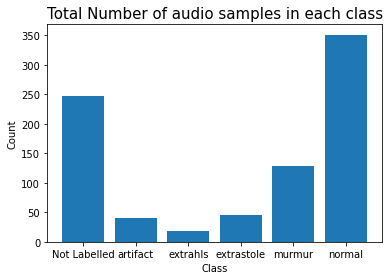

In [ ]:
#Create Bar chart to see the number of audio samples in each Class
Class_Group=train_ab.groupby('label')['dataset'].count().reset_index().rename(columns={'dataset':'count','label' : 'Label'})
print(Class_Group)
plt.bar(Class_Group['Label'],Class_Group['count'])
plt.title("Total Number of audio samples in each class",fontsize=15)
plt.xlabel('Class',fontsize=10)
plt.ylabel('Count',fontsize=10)
plt.tick_params(axis='both',labelsize=10)
plt.show()

## **Comments**
Work on how to deal with NAN values.
One option is to manually label the data after listening to the audio file.

## **Load one murmur audio file from set a**

In [ ]:
#path of the audio file
murmur = '/content/drive/MyDrive/Dataset/set_a/murmur__201108222255.wav'

#This returns an audio time series as a numpy array with samplingng rate of 44.1KHz
m,t = librosa.load(murmur, sr=44000)


## **Listen to Audio**

In [ ]:
import IPython.display as ipd
ipd.Audio(murmur)

In [ ]:
normal = '/content/drive/MyDrive/Dataset/set_a/normal__201101070538.wav'
n,x = librosa.load(normal, sr=44000)
ipd.Audio(normal)

In [ ]:
extrastole = '/content/drive/MyDrive/Dataset/set_b/extrastole__298_1311685888900_C.wav'
e,f = librosa.load(extrastole, sr=44000)
ipd.Audio(extrastole)

In [ ]:
artifact = '/content/drive/MyDrive/Dataset/set_a/artifact__201012172012.wav'
a, b = librosa.load(artifact, sr=44000)
ipd.Audio(artifact)

In [ ]:
extrahls = '/content/drive/MyDrive/Dataset/set_a/extrahls__201103170134.wav'
y, sr = librosa.load(extrahls, sr=44000)
ipd.Audio(extrahls)

### Get Histogram of Durations

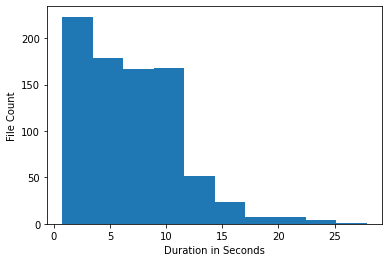

In [ ]:
duration = []
directory = r'/content/drive/MyDrive/Dataset/set_a/'
for filename in os.listdir(directory):
    if filename.endswith(".wav"):
        duration.append(librosa.get_duration(filename = directory + filename))
    else:
        continue

directorysetb = r'/content/drive/MyDrive/Dataset/set_b/'
for filename in os.listdir(directorysetb):
    if filename.endswith(".wav"):
        duration.append(librosa.get_duration(filename = directorysetb + filename))
    else:
        continue

plt.hist(duration)
plt.xlabel("Duration in Seconds")
plt.ylabel("File Count")
plt.show()



Spectrogram: A spectrogram is a visual way of representing the signal strength, or “loudness”, of a signal over time at various frequencies present in a particular waveform. Not only can one see whether there is more or less energy at, for example, 2 Hz vs 10 Hz, but one can also see how energy levels vary over time.

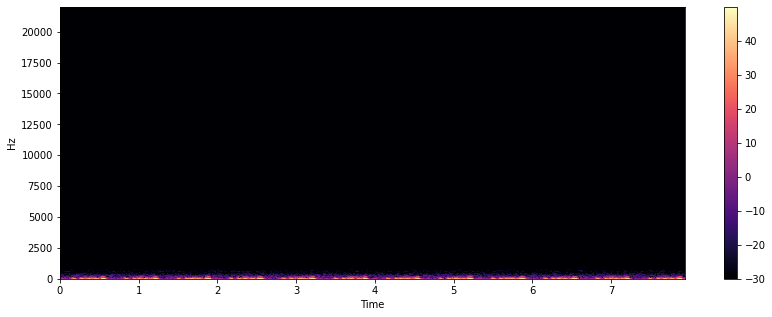

In [ ]:
# for murmur
X = librosa.stft(m)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(14, 5))
librosa.display.specshow(Xdb, sr=t, x_axis='time', y_axis='hz')
plt.colorbar()

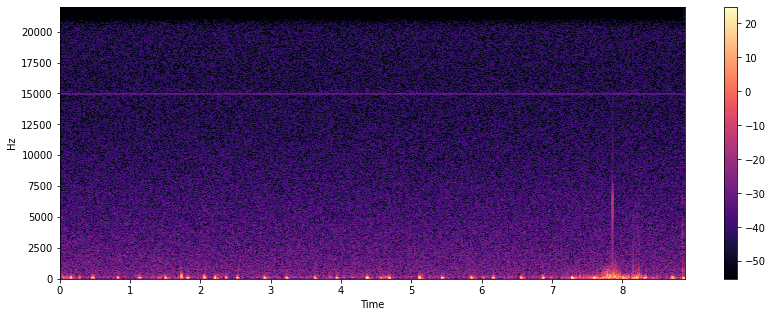

In [ ]:
# for normal
X = librosa.stft(n)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(14, 5))
librosa.display.specshow(Xdb, sr=x, x_axis='time', y_axis='hz')
plt.colorbar()


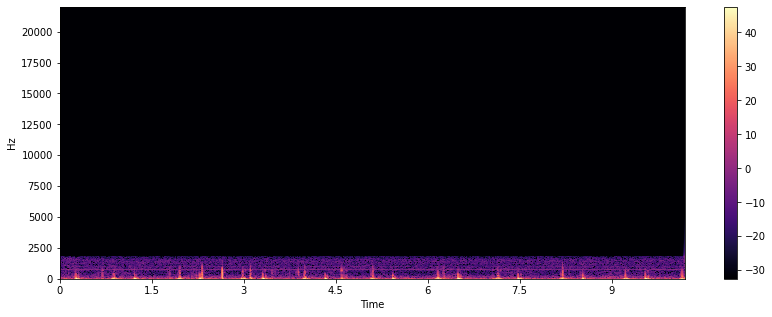

In [ ]:
# for extrastole
X = librosa.stft(e)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(14, 5))
librosa.display.specshow(Xdb, sr=f, x_axis='time', y_axis='hz')
plt.colorbar()


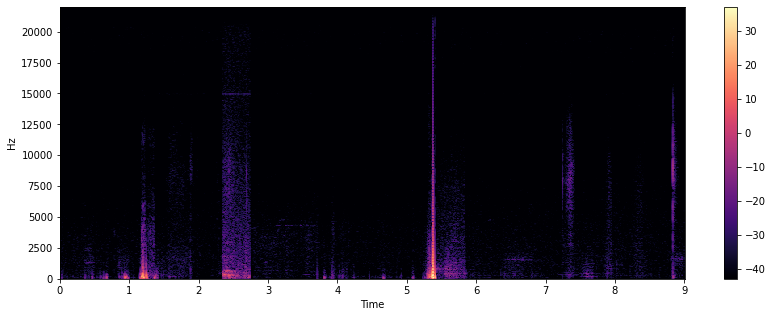

In [ ]:
# for artifact
X = librosa.stft(a)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(14, 5))
librosa.display.specshow(Xdb, sr=b, x_axis='time', y_axis='hz')
plt.colorbar()


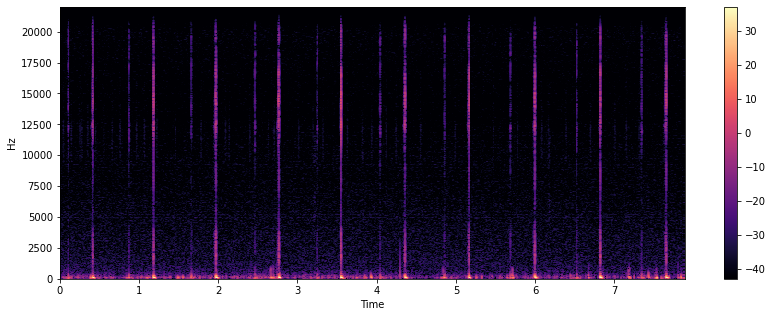

In [ ]:
# for extrahls
X = librosa.stft(y)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(14, 5))
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz')
plt.colorbar()

### Graph Time Series of Frequencies

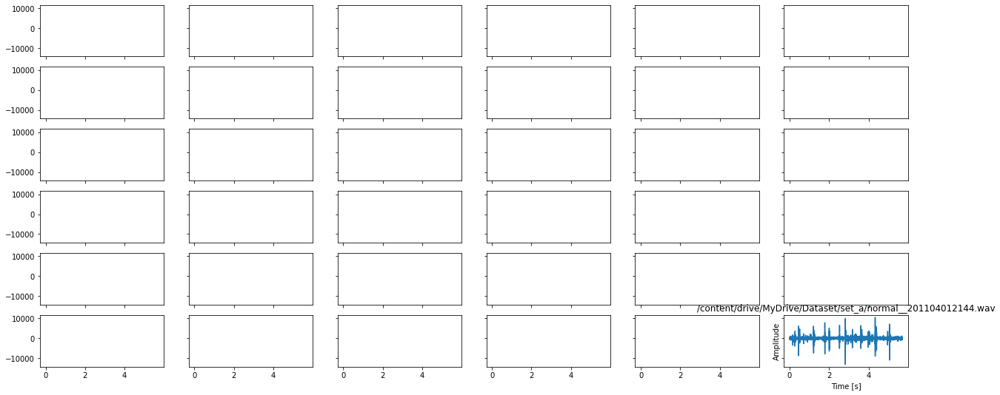

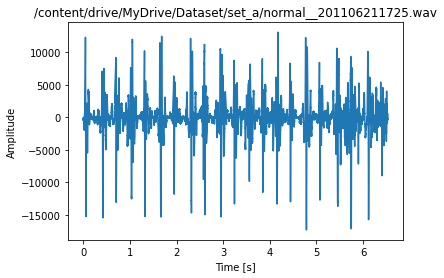

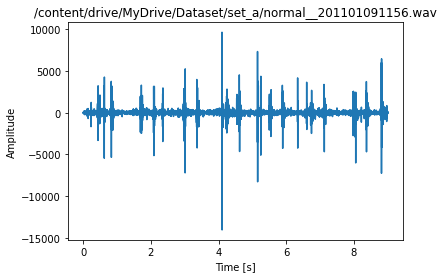

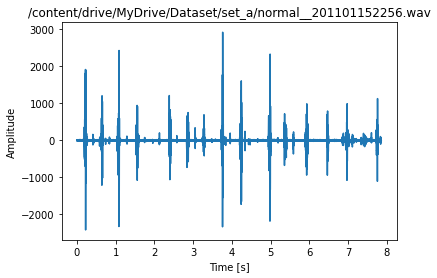

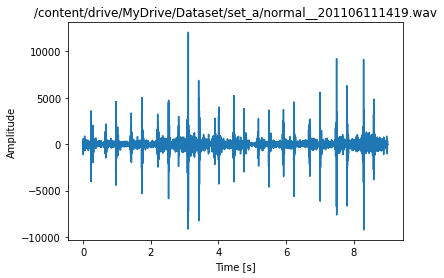

...

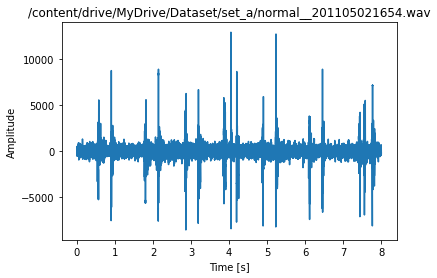

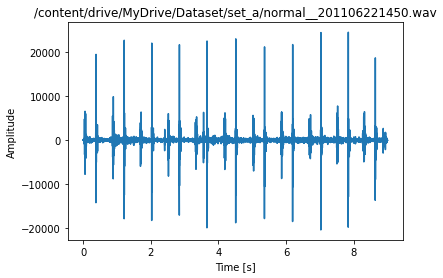

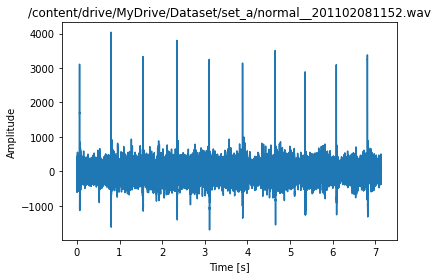

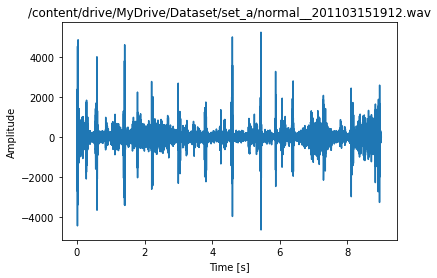

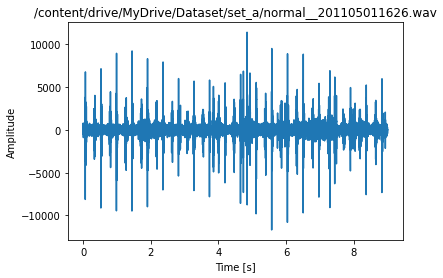

In [ ]:
fig, axes = plt.subplots(nrows=6, ncols=6, figsize=(21,9), sharex=True, sharey=True)
directory = r'/content/drive/MyDrive/Dataset/set_a/'
for filename in os.listdir(directory):
    if filename.startswith("normal"):
        samplerate, data = read(directory + filename)
        duration = len(data)/samplerate
        time = np.arange(0,duration,1/samplerate) #time vector
        plt.plot(time,data)
        plt.xlabel('Time [s]')
        plt.ylabel('Amplitude')
        plt.title(directory + filename)
        plt.show()
    else:
        continue


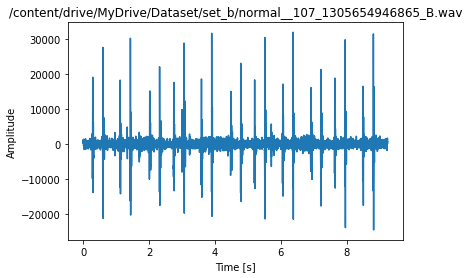

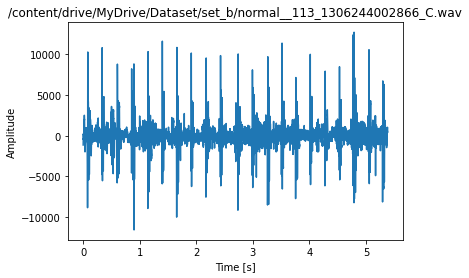

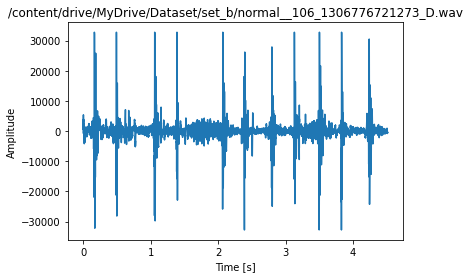

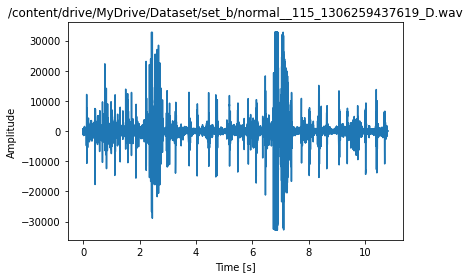

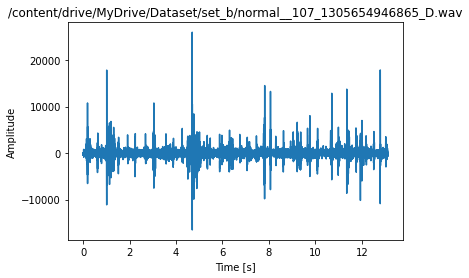

...

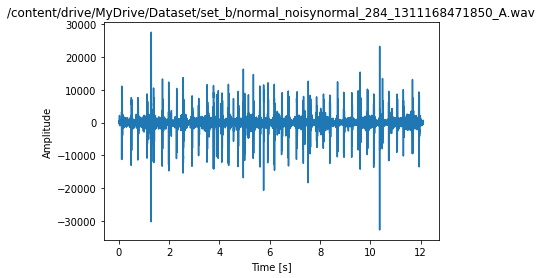

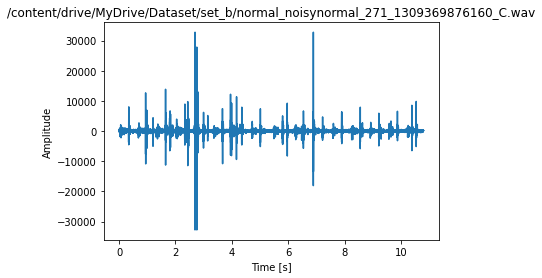

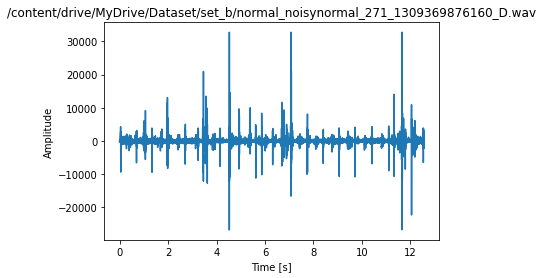

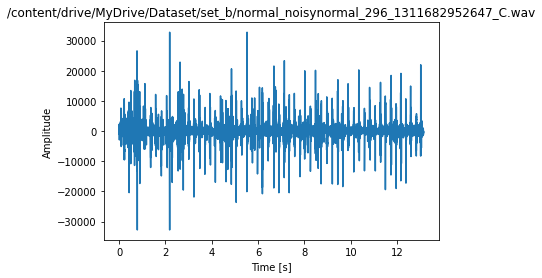

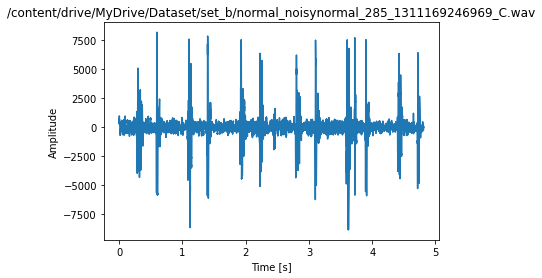

In [ ]:
directory = r'/content/drive/MyDrive/Dataset/set_b/'
for filename in os.listdir(directory):
    if filename.startswith("normal"):
        samplerate, data = read(directory + filename)
        duration = len(data)/samplerate
        time = np.arange(0,duration,1/samplerate) #time vector
        plt.plot(time,data)
        plt.xlabel('Time [s]')
        plt.ylabel('Amplitude')
        plt.title(directory + filename)
        plt.show()
    else:
        continue

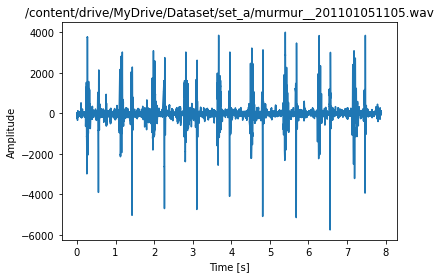

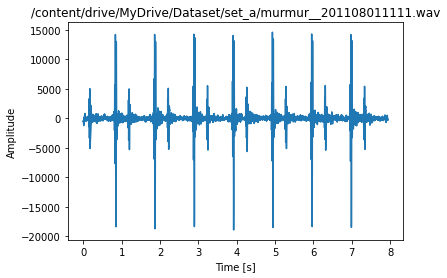

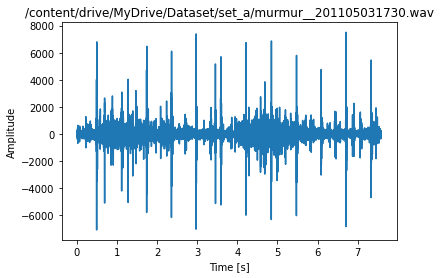

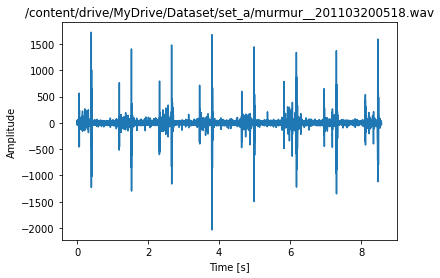

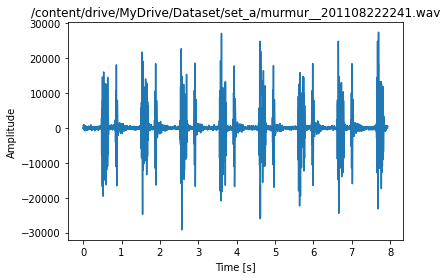

...

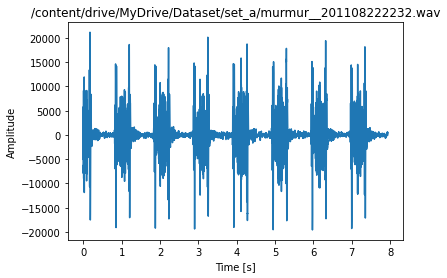

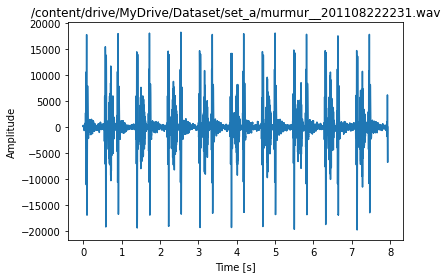

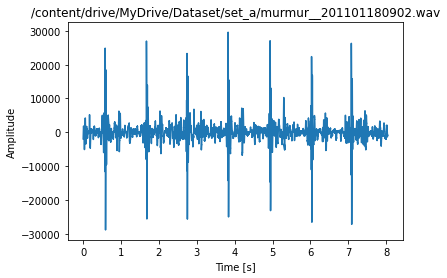

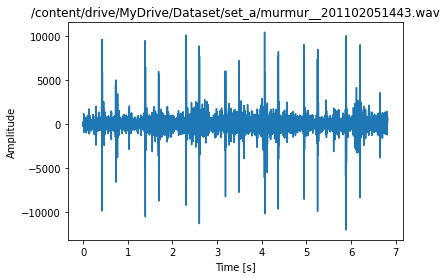

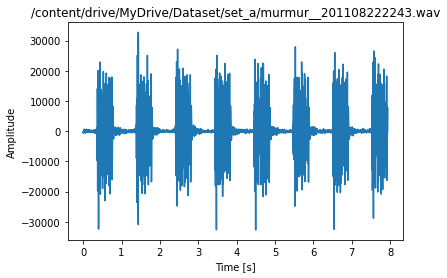

In [ ]:
directory = r'/content/drive/MyDrive/Dataset/set_a/'
for filename in os.listdir(directory):
    if filename.startswith("murmur"):
        samplerate, data = read(directory + filename)
        duration = len(data)/samplerate
        time = np.arange(0,duration,1/samplerate) #time vector
        plt.plot(time,data)
        plt.xlabel('Time [s]')
        plt.ylabel('Amplitude')
        plt.title(directory + filename)
        plt.show()
    else:
        continue


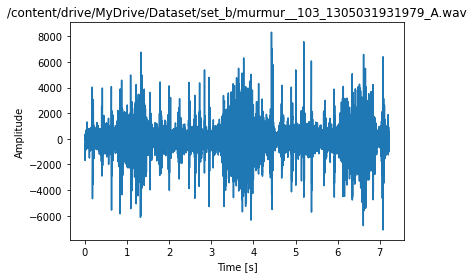

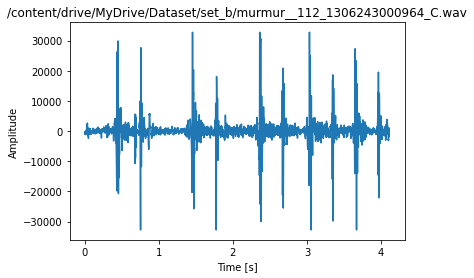

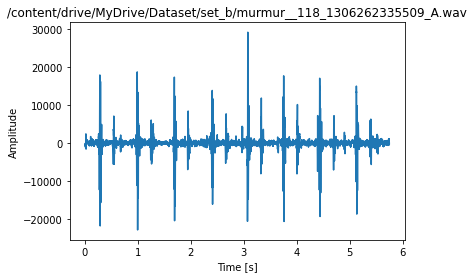

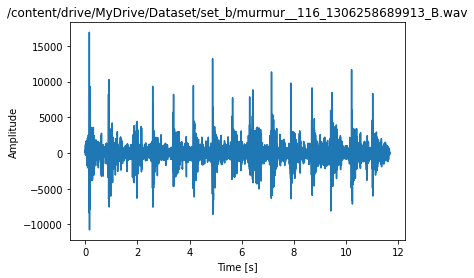

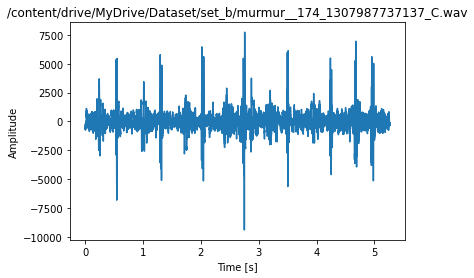

...

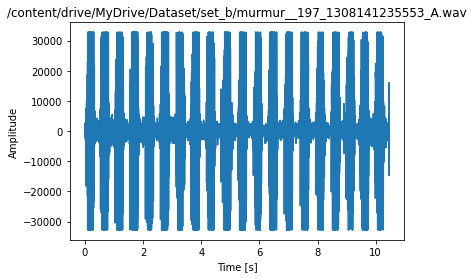

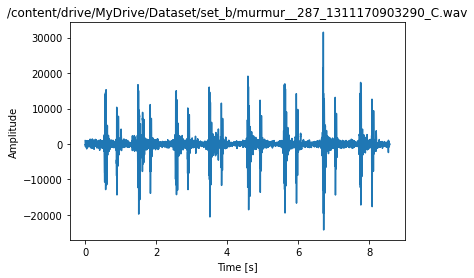

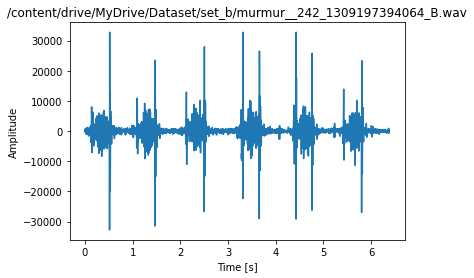

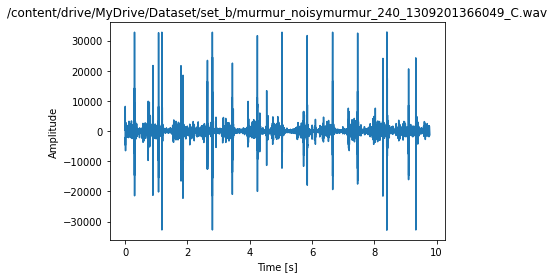

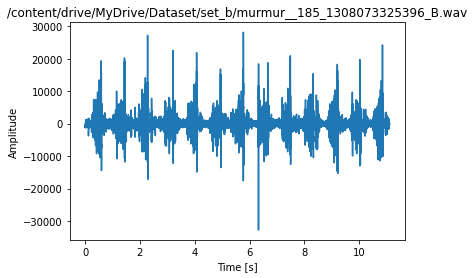

ValueError: ignored

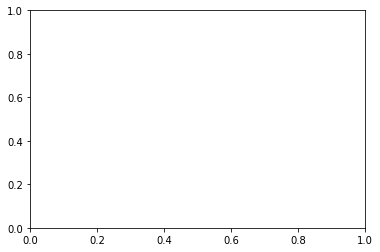

In [ ]:
directory = r'/content/drive/MyDrive/Dataset/set_b/'
for filename in os.listdir(directory):
    if filename.startswith("murmur"):
        samplerate, data = read(directory + filename)
        duration = len(data)/samplerate
        time = np.arange(0,duration,1/samplerate) #time vector
        plt.plot(time,data)
        plt.xlabel('Time [s]')
        plt.ylabel('Amplitude')
        plt.title(directory + filename)
        plt.show()
    else:
        continue

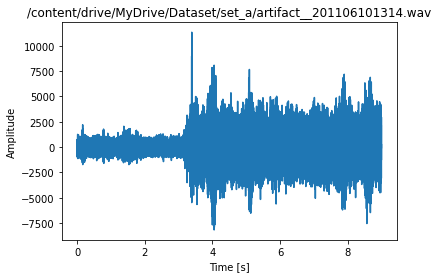

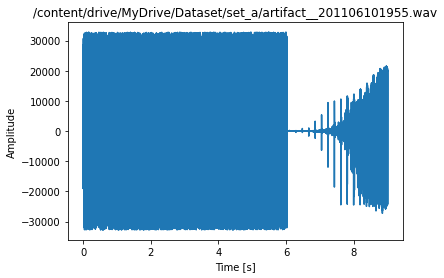

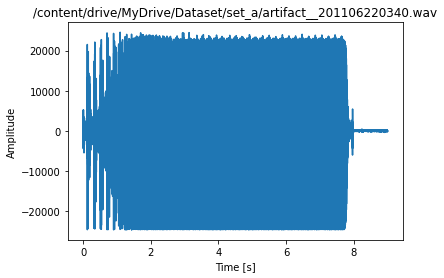

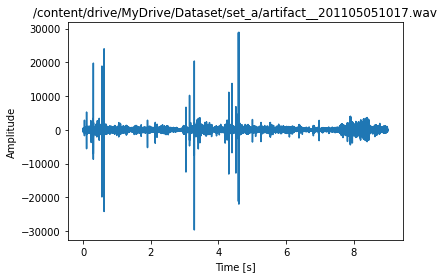

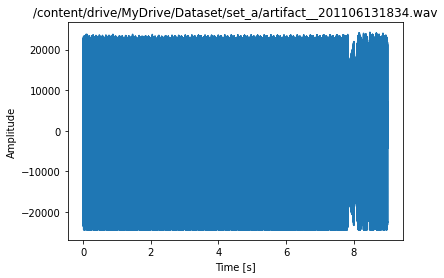

...

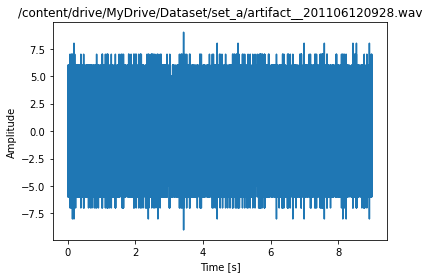

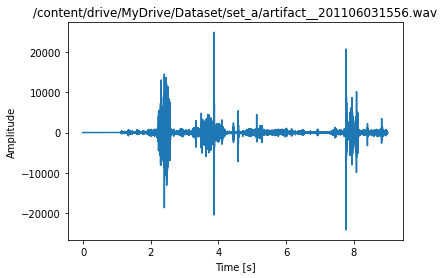

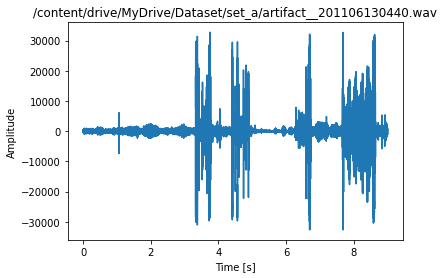

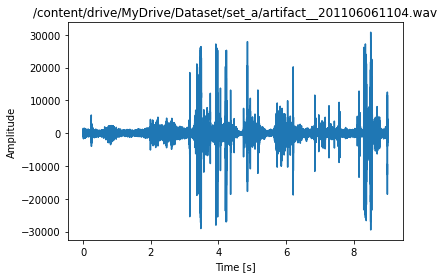

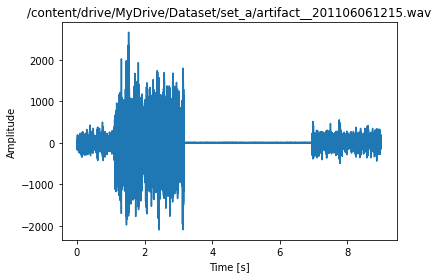

In [ ]:
directory = r'/content/drive/MyDrive/Dataset/set_a/'
for filename in os.listdir(directory):
    if filename.startswith("artifact"):
        samplerate, data = read(directory + filename)
        duration = len(data)/samplerate
        time = np.arange(0,duration,1/samplerate) #time vector
        plt.plot(time,data)
        plt.xlabel('Time [s]')
        plt.ylabel('Amplitude')
        plt.title(directory + filename)
        plt.show()
    else:
        continue

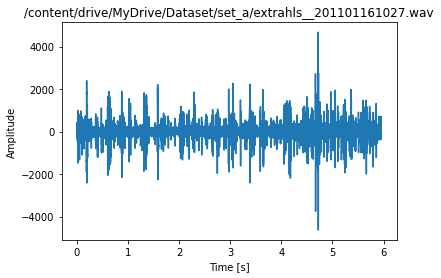

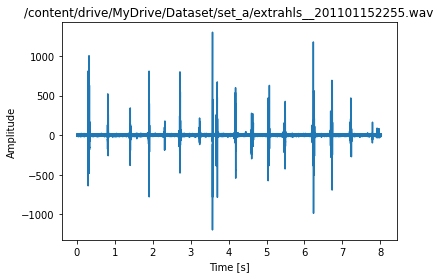

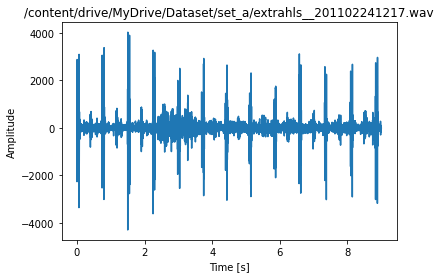

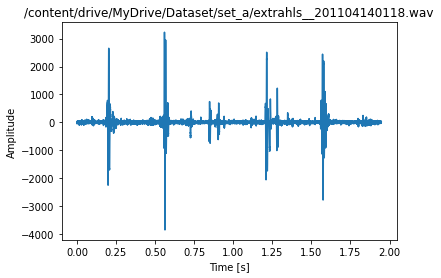

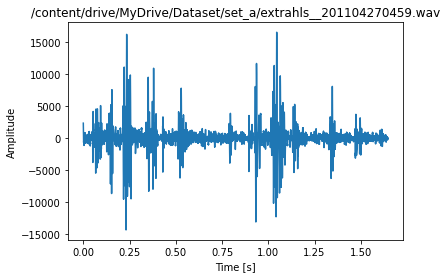

...

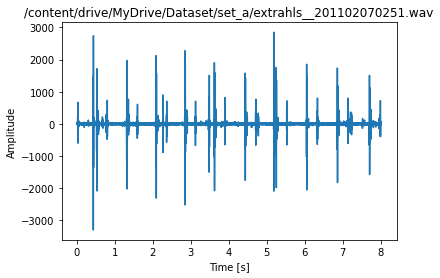

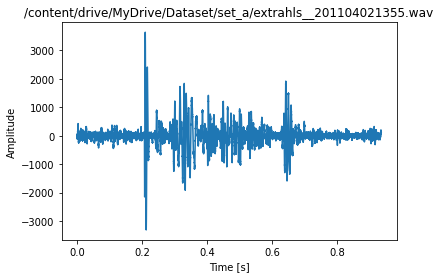

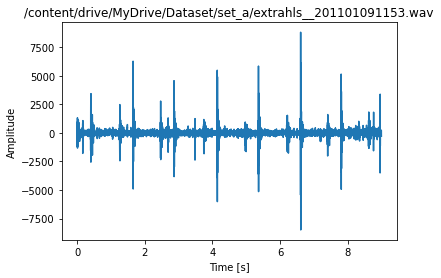

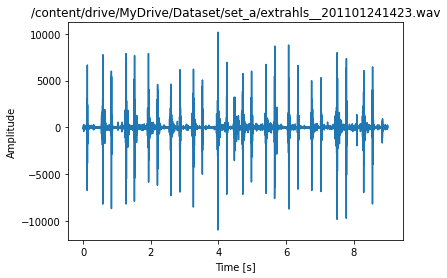

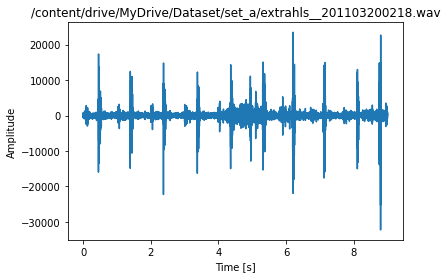

In [ ]:
directory = r'/content/drive/MyDrive/Dataset/set_a/'
for filename in os.listdir(directory):
    if filename.startswith("extrahls"):
        samplerate, data = read(directory + filename)
        duration = len(data)/samplerate
        time = np.arange(0,duration,1/samplerate) #time vector
        plt.plot(time,data)
        plt.xlabel('Time [s]')
        plt.ylabel('Amplitude')
        plt.title(directory + filename)
        plt.show()
    else:
        continue

In [ ]:
directory = r'/content/drive/MyDrive/Dataset/set_b/'
for filename in os.listdir(directory):
    if filename.startswith("extrastole"):
        samplerate, data = read(directory + filename)
        duration = len(data)/samplerate
        time = np.arange(0,duration,1/samplerate) #time vector
        plt.plot(time,data)
        plt.xlabel('Time [s]')
        plt.ylabel('Amplitude')
        plt.title(directory + filename)
        plt.show()
    else:
        continue

In [ ]:
directory = r'/content/drive/MyDrive/Dataset/set_a/'
for filename in os.listdir(directory):
    if filename.startswith("Aunlabelledtest"):
        samplerate, data = read(directory + filename)
        duration = len(data)/samplerate
        time = np.arange(0,duration,1/samplerate) #time vector
        plt.plot(time,data)
        plt.xlabel('Time [s]')
        plt.ylabel('Amplitude')
        plt.title(directory + filename)
        plt.show()
    else:
        continue

#Assign Values to Unlabelled data in set a based on the graph and sound similarity with other beat sounds

In [ ]:

train_ab.loc[train_ab['fname'] =="set_a/__201012172010.wav" , ["label"]] = "artifact"
train_ab.loc[train_ab['fname'] =="set_a/__201101051105.wav" , ["label"]] = "murmur"
train_ab.loc[train_ab['fname'] =="set_a/__201101061552.wav" , ["label"]] = "murmur"
train_ab.loc[train_ab['fname'] =="set_a/__201101091156.wav" , ["label"]] = "normal"
train_ab.loc[train_ab['fname'] =="set_a/__201101110659.wav" , ["label"]] = "normal"
train_ab.loc[train_ab['fname'] =="set_a/__201101152256.wav" , ["label"]] = "normal"
train_ab.loc[train_ab['fname'] =="set_a/__201101220549.wav" , ["label"]] = "normal"
train_ab.loc[train_ab['fname'] =="set_a/__201101241434.wav" , ["label"]] = "normal"
train_ab.loc[train_ab['fname'] =="set_a/__201102081033.wav" , ["label"]] = "artifact"
train_ab.loc[train_ab['fname'] =="set_a/__201102081045.wav" , ["label"]] = "normal"
train_ab.loc[train_ab['fname'] =="set_a/__201102200848.wav" , ["label"]] = "artifact"
train_ab.loc[train_ab['fname'] =="set_a/__201103011036.wav" , ["label"]] = "normal"
train_ab.loc[train_ab['fname'] =="set_a/__201103140236.wav" , ["label"]] = "normal"
train_ab.loc[train_ab['fname'] =="set_a/__201103170122.wav" , ["label"]] = "normal"
train_ab.loc[train_ab['fname'] =="set_a/__201103200518.wav" , ["label"]] = "murmur"
train_ab.loc[train_ab['fname'] =="set_a/__201103201314.wav" , ["label"]] = "normal"
train_ab.loc[train_ab['fname'] =="set_a/__201103232251.wav" , ["label"]] = "artifact"
train_ab.loc[train_ab['fname'] =="set_a/__201103241336.wav" , ["label"]] = "normal"
train_ab.loc[train_ab['fname'] =="set_a/__201104012144.wav" , ["label"]] = "normal"
train_ab.loc[train_ab['fname'] =="set_a/__2011040239.wav" , ["label"]] = "normal"
train_ab.loc[train_ab['fname'] =="set_a/__201105011546.wav" , ["label"]] = "normal"
train_ab.loc[train_ab['fname'] =="set_a/__20110501548.wav" , ["label"]] = "normal"
train_ab.loc[train_ab['fname'] =="set_a/__201105031730.wav" , ["label"]] = "murmur"
train_ab.loc[train_ab['fname'] =="set_a/__201106010807.wav" , ["label"]] = "artifact"
train_ab.loc[train_ab['fname'] =="set_a/__201106030607.wav" , ["label"]] = "artifact"
train_ab.loc[train_ab['fname'] =="set_a/__201106031556.wav" , ["label"]] = "artifact"
train_ab.loc[train_ab['fname'] =="set_a/__201106040930.wav" , ["label"]] = "artifact"
train_ab.loc[train_ab['fname'] =="set_a/__201106061104.wav" , ["label"]] = "artifact"
train_ab.loc[train_ab['fname'] =="set_a/__201106061215.wav" , ["label"]] = "artifact"
train_ab.loc[train_ab['fname'] =="set_a/__201106100606.wav" , ["label"]] = "artifact"
train_ab.loc[train_ab['fname'] =="set_a/__201106111419.wav" , ["label"]] = "normal"
train_ab.loc[train_ab['fname'] =="set_a/__201106120928.wav" , ["label"]] = "artifact"
train_ab.loc[train_ab['fname'] =="set_a/__201106130440.wav" , ["label"]] = "artifact"
train_ab.loc[train_ab['fname'] =="set_a/__201106150614.wav" , ["label"]] = "artifact"
train_ab.loc[train_ab['fname'] =="set_a/__201106170857.wav" , ["label"]] = "artifact"
train_ab.loc[train_ab['fname'] =="set_a/__201106171155.wav" , ["label"]] = "artifact"
train_ab.loc[train_ab['fname'] =="set_a/__201106191034.wav" , ["label"]] = "artifact"
train_ab.loc[train_ab['fname'] =="set_a/__201106211725.wav" , ["label"]] = "normal"
train_ab.loc[train_ab['fname'] =="set_a/__201106212102.wav" , ["label"]] = "artifact"
train_ab.loc[train_ab['fname'] =="set_a/__201108011111.wav" , ["label"]] = "murmur"
train_ab.loc[train_ab['fname'] =="set_a/__201108011113.wav" , ["label"]] = "normal"
train_ab.loc[train_ab['fname'] =="set_a/__201108011116.wav" , ["label"]] = "murmur"
train_ab.loc[train_ab['fname'] =="set_a/__201108011117.wav" , ["label"]] = "murmur"
train_ab.loc[train_ab['fname'] =="set_a/__201108222222.wav" , ["label"]] = "murmur"
train_ab.loc[train_ab['fname'] =="set_a/__201108222225.wav" , ["label"]] = "murmur"
train_ab.loc[train_ab['fname'] =="set_a/__201108222228.wav" , ["label"]] = "murmur"
train_ab.loc[train_ab['fname'] =="set_a/__201108222234.wav" , ["label"]] = "murmur"
train_ab.loc[train_ab['fname'] =="set_a/__201108222241.wav" , ["label"]] = "murmur"
train_ab.loc[train_ab['fname'] =="set_a/__201108222244.wav" , ["label"]] = "murmur"
train_ab.loc[train_ab['fname'] =="set_a/__201108222247.wav" , ["label"]] = "murmur"
train_ab.loc[train_ab['fname'] =="set_a/__201108222254.wav" , ["label"]] = "murmur"
train_ab.loc[train_ab['fname'] =="set_a/__201108222257.wav" , ["label"]] = "murmur"




In [ ]:
train_ab[train_ab["label"]=="Not Labelled"].count()


In [ ]:
#Display unlablled in dataset b
directory = r'/content/drive/MyDrive/archive/set_b/'
for filename in os.listdir(directory):
    if filename.startswith("Bunlabelledtest"):
        samplerate, data = read(directory + filename)
        duration = len(data)/samplerate
        time = np.arange(0,duration,1/samplerate) #time vector
        plt.plot(time,data)
        plt.xlabel('Time [s]')
        plt.ylabel('Amplitude')
        plt.title(directory + filename)
        plt.show()
    else:
        continue

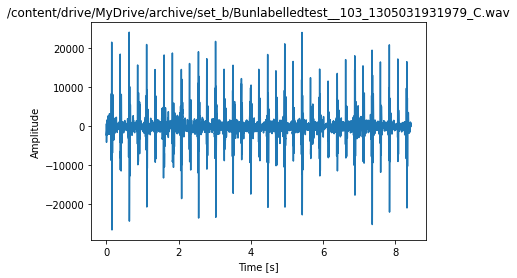

In [ ]:
directory = r'/content/drive/MyDrive/archive/'
filename='set_b/Bunlabelledtest__103_1305031931979_C.wav'
samplerate, data = read(directory + filename)
duration = len(data)/samplerate
time = np.arange(0,duration,1/samplerate) #time vector
plt.plot(time,data)
plt.xlabel('Time [s]')
plt.ylabel('Amplitude')
plt.title(directory + filename)
plt.show()


In [ ]:
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_101_1305030823364_A.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_101_1305030823364_D.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_101_1305030823364_F.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_103_1305031931979_A.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_103_1305031931979_C.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_105_1305033453095_B.wav",["label"]]="artifact"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_105_1305033453095_D.wav",["label"]]="extrastole"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_106_1306776721273_B.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_106_1306776721273_D.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_107_1305654946865_B.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_107_1305654946865_D.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_108_1305654420093_C.wav",["label"]]="artifact"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_109_1305653646620_B.wav",["label"]]="extrastole"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_109_1305653646620_D.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_109_1305653972028_B.wav",["label"]]="extrastole"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_109_1305653972028_D.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_110_1305655332337_D.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_112_1306243000964_C.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_113_1306244002866_C.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_115_1306259437619_D.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_116_1306258689913_B.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_117_1306262456650_B1.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_118_1306262335509_A.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_118_1306262335509_A1.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_118_1306262335509_C2.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_121_1306263877235_B.wav",["label"]]="artifact"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_122_1306325762831_A.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_122_1306325762831_B.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_123_1306331925797_A.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_123_1306331925797_D.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_125_1306332456645_B2.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_126_1306777102824_C1.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_126_1306777102824_D1.wav",["label"]]="artifact"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_127_1306764300147_D.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_128_1306344005749_C.wav",["label"]]="extrastole"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_129_1306344506305_B.wav",["label"]]="extrastole"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_130_1306347376079_A.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_132_1306758754432_A.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_132_1306758754432_B.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_132_1306758754432_D.wav",["label"]]="artifact"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_134_1306428161797_A.wav",["label"]]="artifact"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_134_1306428161797_B.wav",["label"]]="extrastole"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_135_1306428972976_D.wav",["label"]]="artifact"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_136_1306429977501_A.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_136_1306429977501_D.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_137_1306764999211_A.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_137_1306764999211_B1.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_137_1306764999211_D2.wav",["label"]]="artifact"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_138_1306762146980_C.wav",["label"]]="extrastole"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_139_1306519274653_B.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_139_1306519274653_C.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_141_1306520154450_A.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_141_1306520154450_D.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_142_1306763049574_C.wav",["label"]]="artifact"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_143_1306763822290_D.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_144_1306522408528_A.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_145_1307987561278_A.wav",["label"]]="artifact"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_145_1307987561278_D.wav",["label"]]="extrastole"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_146_1306778707532_C.wav",["label"]]="extrastole"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_146_1306778707532_D31.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_147_1306523973811_D.wav",["label"]]="artifact"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_148_1306768801551_A.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_148_1306768801551_C.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_148_1306768801551_D.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_149_1306776016110_C.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_150_1306776340746_D.wav",["label"]]="extrastole"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_151_1306779785624_A1.wav",["label"]]="artifact"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_152_1306779561195_B.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_152_1306779561195_C.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_152_1306779561195_D1.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_153_1306848820671_D.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_154_1306935608852_A.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_154_1306935608852_A2.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_154_1306935608852_D.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_154_1306935608852_D1.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_155_1306935902813_B.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_155_1306935902813_B2.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_155_1306935902813_D.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_156_1306936373241_C.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_156_1306936373241_D.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_157_1306937583792_C.wav",["label"]]="artifact"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_159_1307018640315_A.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_159_1307018640315_B.wav",["label"]]="extrastole"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_159_1307018640315_C.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_160_1307100683334_C.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_161_1307101199321_D.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_162_1307101835989_C.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_163_1307104470471_B.wav",["label"]]="extrastole"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_163_1307104470471_B1.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_163_1307104470471_D.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_164_1307106095995_D.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_165_1307109069581_B.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_167_1307111318050_C1.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_167_1307111318050_D.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_169_1307970398039_B.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_169_1307970398039_C1.wav",["label"]]="extrastole"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_170_1307970562729_D.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_171_1307971016233_C.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_171_1307971016233_F.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_172_1307971284351_C.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_172_1307971284351_D.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_173_1307973611151_D.wav",["label"]]="extrastole"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_174_1307987737137_C.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_175_1307987962616_C.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_176_1307988171173_A1.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_176_1307988171173_C.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_176_1307988171173_C1.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_177_1307989650056_C.wav",["label"]]="extrastole"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_178_1307989887769_A.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_179_1307990076841_D1.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_180_1307990956284_B.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_180_1307990956284_D.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_181_1308052613891_C.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_184_1308073010307_C.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_186_1308073648738_C.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_186_1308073648738_D1.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_187_1308073994223_C.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_189_1308075231945_A.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_189_1308075231945_C.wav",["label"]]="extrastole"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_191_1308077299430_C.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_191_1308077299430_D.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_193_1308078104592_A.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_193_1308078104592_D.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_194_1308139824187_C.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_195_1308140095331_D.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_196_1308141034858_D.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_197_1308141235553_B.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_200_1308144251434_C1.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_201_1308144942432_B.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_202_1308145175747_B.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_203_1308162026258_C.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_204_1308159229275_B1.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_206_1308159601959_C1.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_207_1308159792607_B3.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_209_1308162216750_B.wav",["label"]]="extrastole"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_209_1308162216750_C.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_210_1308162935880_D.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_212_1308245076477_C.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_213_1308245263936_B.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_214_1308245489717_A1.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_215_1308245664733_D.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_216_1308245839516_B1.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_217_1308246111629_A.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_217_1308246111629_B.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_217_1308246111629_D.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_220_1308250132896_A.wav",["label"]]="extrastole"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_222_1308336218979_B.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_227_1308594233667_D.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_229_1308594979317_C.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_231_1308748318393_B.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_231_1308748318393_C.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_232_1308748524018_A1.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_232_1308748524018_D.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_235_1308749032454_C1.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_235_1308749032454_D1.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_237_1308750231222_C1.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_239_1309195730333_D.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_240_1309196119795_D.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_242_1309197394064_A.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_242_1309197394064_C.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_243_1309197760898_D.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_245_1309198844065_A.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_245_1309200438094_C.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_248_1309201683806_B.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_248_1309201683806_D.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_254_1309350589009_B.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_255_1309351210897_B.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_259_1309352630271_B.wav",["label"]]="extrastole"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_260_1309353164458_A.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_262_1309355283807_B.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_264_1309356143724_A.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_268_1309368960960_A.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_268_1309368960960_E.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_270_1309369533040_D.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_271_1309369876160_B.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_272_1309370164386_B.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_274_1311075637574_C.wav",["label"]]="extrastole"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_278_1311163365896_C.wav",["label"]]="extrastole"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_278_1311163365896_D.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_280_1311165195344_B.wav",["label"]]="extrastole"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_281_1311165683454_C.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_282_1311166081161_D.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_284_1311168471850_C.wav",["label"]]="extrastole"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_286_1311170606028_B.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_287_1311170903290_D.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_288_1311164615284_B.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_290_1311182875320_B.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_293_1311680805936_B.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_293_1311680805936_B2.wav",["label"]]="murmur"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_294_1311681084248_D.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_296_1311682952647_A.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_296_1311682952647_B.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_300_1311772096120_B.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_300_1311772096120_C.wav",["label"]]="normal"
train_ab.loc[train_ab["fname"]=="set_b/Bunlabelledtest_300_1311772096120_D.wav",["label"]]="normal"


In [ ]:
train_ab[train_ab["label"]=="Not Labelled"].count()

dataset     0
fname       0
label       0
sublabel    0
dtype: int64

In [ ]:
train_ab.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 832 entries, 0 to 655
Data columns (total 4 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   dataset   832 non-null    object
 1   fname     832 non-null    object
 2   label     832 non-null    object
 3   sublabel  149 non-null    object
dtypes: object(4)
memory usage: 32.5+ KB


        Label  count
0    artifact     71
1    extrahls     19
2  extrastole     69
3      murmur    190
4      normal    483


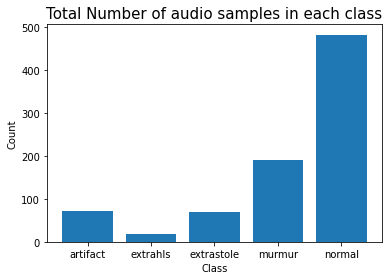

In [ ]:
#Create Bar chart to see the number of audio samples in each Class
Class_Group=train_ab.groupby('label')['dataset'].count().reset_index().rename(columns={'dataset':'count','label' : 'Label'})
print(Class_Group)
plt.bar(Class_Group['Label'],Class_Group['count'])
plt.title("Total Number of audio samples in each class",fontsize=15)
plt.xlabel('Class',fontsize=10)
plt.ylabel('Count',fontsize=10)
plt.tick_params(axis='both',labelsize=10)
plt.show()

In [ ]:
#Rename Extrahls to extrastole
train_ab['label'] = train_ab['label'].str.replace('extrahls', 'extrastole')

        Label  count
0    artifact     71
1  extrastole     88
2      murmur    190
3      normal    483


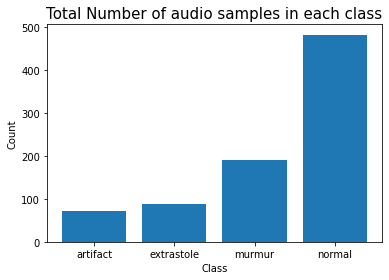

In [ ]:
#Create Bar chart to see the number of audio samples in each Class
Class_Group=train_ab.groupby('label')['dataset'].count().reset_index().rename(columns={'dataset':'count','label' : 'Label'})
print(Class_Group)
plt.bar(Class_Group['Label'],Class_Group['count'])
plt.title("Total Number of audio samples in each class",fontsize=15)
plt.xlabel('Class',fontsize=10)
plt.ylabel('Count',fontsize=10)
plt.tick_params(axis='both',labelsize=10)
plt.show()

Loading the data for Modeling

In [ ]:
# Audio Preprocessing Function i.e. Add padding to make audio files of same length
# Extract MFCC features from audio .wav file)
def load_file_data (folder,file_names, duration=12, sr=16000):
    input_length=sr*duration
    # function to load files and extract features
    # file_names = glob.glob(os.path.join(folder, '*.wav'))
    data = []
    for file_name in file_names:
        try:
            sound_file=folder+file_name
            print ("load file ",sound_file)
            # use kaiser_fast technique for faster extraction
            X, sr = librosa.load( sound_file, sr=sr, duration=duration,res_type='kaiser_fast') 
            dur = librosa.get_duration(y=X, sr=sr)
            # pad audio file same duration
            if (round(dur) < duration):
                print ("fixing audio lenght :", file_name)
                y = librosa.util.fix_length(X, input_length)                
            #normalized raw audio 
            # y = audio_norm(y)            
            # extract normalized mfcc feature from data
            mfccs = np.mean(librosa.feature.mfcc(y=X, sr=sr, n_mfcc=40).T,axis=0)             
        except Exception as e:
            print("Error encountered while parsing file: ", file)        
        feature = np.array(mfccs).reshape([-1,1])
        data.append(feature)
    return data

In [ ]:
# simple encoding of categories, limited to 3 types
from sklearn.model_selection import train_test_split
from sklearn import preprocessing

# Map label text to integer
CLASSES = ['artifact','murmur','normal','extrastole']
# {'artifact': 0, 'murmur': 1, 'normal': 3,'extrastole':4}
NB_CLASSES=len(CLASSES)

# Map integer value to text labels
label_to_int = {k:v for v,k in enumerate(CLASSES)}
print (label_to_int)
print (" ")
# map integer to label text
int_to_label = {v:k for k,v in label_to_int.items()}
print(int_to_label)

{'artifact': 0, 'murmur': 1, 'normal': 2, 'extrastole': 3}
 
{0: 'artifact', 1: 'murmur', 2: 'normal', 3: 'extrastole'}


In [ ]:
#Gurjus Data path
INPUT_DIR=("/content/drive/MyDrive/Dataset/")
#Maira Data Path
#INPUT_DIR=("/content/drive/MyDrive/archive/")
# 16 KHz
SAMPLE_RATE = 16000
# seconds
MAX_SOUND_CLIP_DURATION=12   

In [ ]:
# load dataset-a
import os, fnmatch

A_folder=INPUT_DIR+'/set_a/'
# set-a
A_artifact_files = fnmatch.filter(os.listdir(INPUT_DIR+'/set_a'), 'artifact*.wav')
A_artifact_sounds = load_file_data(folder=A_folder,file_names=A_artifact_files, duration=MAX_SOUND_CLIP_DURATION)
A_artifact_labels = [0 for items in A_artifact_files]

A_normal_files = fnmatch.filter(os.listdir(INPUT_DIR+'/set_a'), 'normal*.wav')
A_normal_sounds = load_file_data(folder=A_folder,file_names=A_normal_files, duration=MAX_SOUND_CLIP_DURATION)
A_normal_labels = [2 for items in A_normal_sounds]

A_extrahls_files = fnmatch.filter(os.listdir(INPUT_DIR+'/set_a'), 'extrahls*.wav')
A_extrahls_sounds = load_file_data(folder=A_folder,file_names=A_extrahls_files, duration=MAX_SOUND_CLIP_DURATION)
A_extrahls_labels = [3 for items in A_extrahls_sounds]

A_murmur_files = fnmatch.filter(os.listdir(INPUT_DIR+'/set_a'), 'murmur*.wav')
A_murmur_sounds = load_file_data(folder=A_folder,file_names=A_murmur_files, duration=MAX_SOUND_CLIP_DURATION)
A_murmur_labels = [1 for items in A_murmur_files]



print ("loaded dataset-a")

load file  /content/drive/MyDrive/Dataset//set_a/artifact__201106101314.wav
fixing audio lenght : artifact__201106101314.wav
load file  /content/drive/MyDrive/Dataset//set_a/artifact__201106101955.wav
fixing audio lenght : artifact__201106101955.wav
load file  /content/drive/MyDrive/Dataset//set_a/artifact__201106220340.wav
fixing audio lenght : artifact__201106220340.wav
load file  /content/drive/MyDrive/Dataset//set_a/artifact__201105051017.wav
fixing audio lenght : artifact__201105051017.wav
load file  /content/drive/MyDrive/Dataset//set_a/artifact__201106131834.wav
fixing audio lenght : artifact__201106131834.wav
load file  /content/drive/MyDrive/Dataset//set_a/artifact__201106161016.wav
fixing audio lenght : artifact__201106161016.wav
load file  /content/drive/MyDrive/Dataset//set_a/artifact__201106212112.wav
fixing audio lenght : artifact__201106212112.wav
load file  /content/drive/MyDrive/Dataset//set_a/artifact__201106030612.wav
fixing audio lenght : artifact__201106030612.wav


In [ ]:
# load dataset-b
B_folder=INPUT_DIR+'/set_b/'
# set-b
B_artifact_files = fnmatch.filter(os.listdir(INPUT_DIR+'/set_b'), 'artifact*.wav')
B_artifact_sounds = load_file_data(folder=B_folder,file_names=B_artifact_files, duration=MAX_SOUND_CLIP_DURATION)
B_artifact_labels = [0 for items in B_artifact_files]

B_normal_files = fnmatch.filter(os.listdir(INPUT_DIR+'/set_b'), 'normal*.wav')  # include noisy files
B_normal_sounds = load_file_data(folder=B_folder,file_names=B_normal_files, duration=MAX_SOUND_CLIP_DURATION)
B_normal_labels = [2 for items in B_normal_sounds]

B_murmur_files = fnmatch.filter(os.listdir(INPUT_DIR+'/set_b'), 'murmur*.wav')  # include noisy files
B_murmur_sounds = load_file_data(folder=B_folder,file_names=B_murmur_files, duration=MAX_SOUND_CLIP_DURATION)
B_murmur_labels = [1 for items in B_murmur_files]

B_extrastole_files = fnmatch.filter(os.listdir(INPUT_DIR+'/set_b'), 'extrastole*.wav')
B_extrastole_sounds = load_file_data(folder=B_folder,file_names=B_extrastole_files, duration=MAX_SOUND_CLIP_DURATION)
B_extrastole_labels = [3 for items in B_extrastole_files]

print ("loaded dataset-b")

load file  /content/drive/MyDrive/Dataset//set_b/artifact__108_1305654420093_C.wav
load file  /content/drive/MyDrive/Dataset//set_b/artifact__121_1306263877235_B.wav
load file  /content/drive/MyDrive/Dataset//set_b/artifact__105_1305033453095_B.wav
fixing audio lenght : artifact__105_1305033453095_B.wav
load file  /content/drive/MyDrive/Dataset//set_b/artifact__135_1306428972976_D.wav
fixing audio lenght : artifact__135_1306428972976_D.wav
load file  /content/drive/MyDrive/Dataset//set_b/artifact__137_1306764999211_D2.wav
fixing audio lenght : artifact__137_1306764999211_D2.wav
load file  /content/drive/MyDrive/Dataset//set_b/artifact__142_1306763049574_C.wav
load file  /content/drive/MyDrive/Dataset//set_b/artifact__147_1306523973811_D.wav
fixing audio lenght : artifact__147_1306523973811_D.wav
load file  /content/drive/MyDrive/Dataset//set_b/artifact__126_1306777102824_D1.wav
fixing audio lenght : artifact__126_1306777102824_D1.wav
load file  /content/drive/MyDrive/Dataset//set_b/art

In [ ]:
#combine set-a and set-b 

x_data = np.concatenate((A_artifact_sounds, A_normal_sounds,A_extrahls_sounds,A_murmur_sounds, 
                         B_normal_sounds,B_murmur_sounds,B_extrastole_sounds,B_artifact_sounds))

y_data = np.concatenate((A_artifact_labels, A_normal_labels,A_extrahls_labels,A_murmur_labels,
                         B_normal_labels,B_murmur_labels,B_extrastole_labels,B_artifact_labels))


#print ("combined training data record: ",len(y_data), len(test_y))

In [ ]:
seed = 1000
# split data into Train, Validation and Test i.e 80% of data is training, 10% is validation out of training data and 20% is test data
x_train, x_test, y_train, y_test = train_test_split(x_data, y_data, train_size=0.8, random_state=seed, shuffle=True)
x_train, x_val, y_train, y_val = train_test_split(x_train, y_train, train_size=0.9, random_state=seed, shuffle=True)

# One-Hot encoding for classes
y_train = np.array(keras.utils.to_categorical(y_train, len(CLASSES)))
y_test = np.array(keras.utils.to_categorical(y_test, len(CLASSES)))
y_val = np.array(keras.utils.to_categorical(y_val, len(CLASSES)))


In [ ]:
print ("label shape: ", y_data.shape)
print ("data size of the array: : %s" % y_data.size)
print ("length of one array element in bytes: ", y_data.itemsize)
print ("total bytes consumed by the elements of the array: ", y_data.nbytes)
print (y_data[1])
print ("")
print ("audio data shape: ", x_data.shape)
print ("data size of the array: : %s" % x_data.size)
print ("length of one array element in bytes: ", x_data.itemsize)
print ("total bytes consumed by the elements of the array: ", x_data.nbytes)
#print (x_data[1])
print ("")
print ("training data shape: ", x_train.shape)
print ("training label shape: ", y_train.shape)
print ("")
print ("validation data shape: ", x_val.shape)
print ("validation label shape: ", y_val.shape)
print ("")
print ("test data shape: ", x_test.shape)
print ("test label shape: ", y_test.shape)

label shape:  (832,)
data size of the array: : 832
length of one array element in bytes:  8
total bytes consumed by the elements of the array:  6656
0

audio data shape:  (832, 40, 1)
data size of the array: : 33280
length of one array element in bytes:  4
total bytes consumed by the elements of the array:  133120

training data shape:  (598, 40, 1)
training label shape:  (598,)

validation data shape:  (67, 40, 1)
validation label shape:  (67,)

test data shape:  (167, 40, 1)
test label shape:  (167,)


## **K-mean Clustering**

In [ ]:
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
from sklearn.datasets.samples_generator import make_blobs
from sklearn.cluster import KMeans

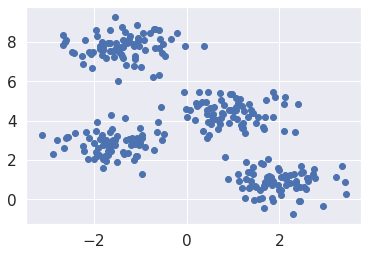

In [ ]:
x_data, y_data = make_blobs(n_samples=300, centers=4, cluster_std=0.60, random_state=0)
plt.scatter(x_data[:,0], x_data[:,1])

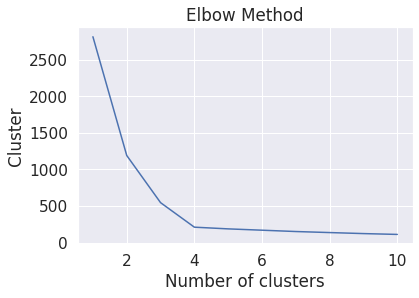

In [ ]:
cluster = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', max_iter=300, n_init=10, random_state=0)
    kmeans.fit(x_data)
    cluster.append(kmeans.inertia_)
plt.plot(range(1, 11), cluster)
plt.title('Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('Cluster')
plt.show()

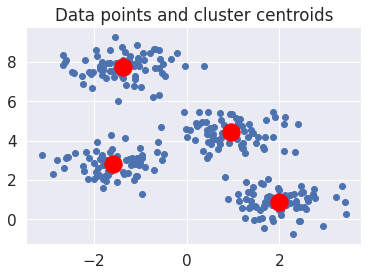

In [ ]:
kmeans = KMeans(n_clusters=4, init='k-means++', max_iter=300, n_init=10, random_state=0)
pred_y = kmeans.fit_predict(x_data)
plt.scatter(x_data[:,0], x_data[:,1])
plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], s=300, c='red')
plt.title('Data points and cluster centroids')
plt.show()



## **Support Vector machines (SVM):**

In [ ]:
seed = 1000
# split data into Train, Validation and Test i.e 80% of data is training, 10% is validation out of training data and 20% is test data
x_train_svm, x_test_svm, y_train_svm, y_test_svm = train_test_split(x_data, y_data, train_size=0.8, random_state=seed, shuffle=True)
x_train_svm, x_val_svm, y_train_svm, y_val_svm = train_test_split(x_train_svm, y_train_svm, train_size=0.9, random_state=seed, shuffle=True)

# One-Hot encoding for classes
#y_train_svm = np.array(keras.utils.to_categorical(y_train, len(CLASSES)))
#y_test_svm = np.array(keras.utils.to_categorical(y_test, len(CLASSES)))
#y_val_svm = np.array(keras.utils.to_categorical(y_val, len(CLASSES)))



In [ ]:
#Import svm model
from sklearn import svm

#Create a svm Classifier
clf = svm.SVC(kernel='linear') # Linear Kernel

#Train the model using the training sets
clf.fit(x_train_svm, y_train_svm)

#Predict the response for test dataset
y_pred_svm = clf.predict(x_test_svm)

#Predict the response for validation data dataset
y_pred_test = clf.predict(x_val_svm)


In [ ]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Model Accuracy: how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test_svm, y_pred_svm))

Accuracy: 1.0


In [ ]:
# Model Precision: what percentage of positive tuples are labeled as such?
print("Precision Score : ",metrics.precision_score(y_test_svm, y_pred_svm, 
                                           pos_label='positive',
                                           average='micro'))

# Model Recall: what percentage of positive tuples are labelled as such?
print("Recall Score : ",metrics.recall_score(y_test_svm, y_pred_svm, 
                                           pos_label='positive',
                                           average='micro'))


Precision Score :  1.0
Recall Score :  1.0


In [ ]:
x_data = np.concatenate((A_artifact_sounds, A_normal_sounds,A_extrahls_sounds,A_murmur_sounds, 
                         B_normal_sounds,B_murmur_sounds,B_extrastole_sounds,B_artifact_sounds))

y_data = np.concatenate((A_artifact_labels, A_normal_labels,A_extrahls_labels,A_murmur_labels,
                         B_normal_labels,B_murmur_labels,B_extrastole_labels,B_artifact_labels))


## **Random Forest Model**

[[10  0  5  0]
 [ 0 16 27  0]
 [ 1  4 90  1]
 [ 0  0 12  1]]
              precision    recall  f1-score   support

           0       0.91      0.67      0.77        15
           1       0.80      0.37      0.51        43
           2       0.67      0.94      0.78        96
           3       0.50      0.08      0.13        13

    accuracy                           0.70       167
   macro avg       0.72      0.51      0.55       167
weighted avg       0.71      0.70      0.66       167

0.7005988023952096


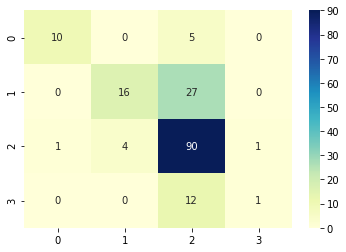

In [ ]:
# Data shape will be different for random forest and neural networks.
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score

#Reshape the data into 2x2
nsamples, nx, ny = x_data.shape
d2_train_dataset = x_data.reshape((nsamples,nx*ny))
seed = 1000
# split data into Train, Validation and Test i.e 80% of data is training, 10% is validation out of training data and 20% is test data
x_trainrf, x_testrf, y_trainrf, y_testrf = train_test_split(d2_train_dataset, y_data, train_size=0.8, random_state=seed, shuffle=True)

#Scaling of the data
sc = StandardScaler()
x_trainrf = sc.fit_transform(x_trainrf)
x_testrf = sc.transform(x_testrf)

#Training the Algorithm
Rf_Model=RandomForestClassifier(n_estimators=100,random_state=0)
Rf_Model.fit(x_trainrf,y_trainrf)


#Predict
y_predrf=Rf_Model.predict(x_testrf)
accuracy_score(y_testrf,y_predrf)

#create confusion matrix

print(confusion_matrix(y_testrf,y_predrf))
print(classification_report(y_testrf,y_predrf))
print(accuracy_score(y_testrf, y_predrf))

sns.heatmap(confusion_matrix(y_testrf,y_predrf),annot=True,cmap="YlGnBu")





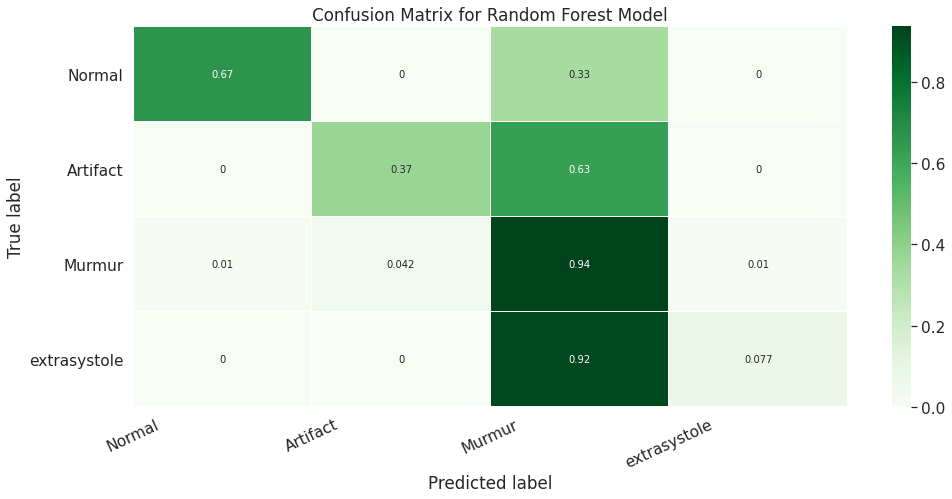

In [ ]:
# Get and reshape confusion matrix data
matrix = confusion_matrix(y_testrf, y_predrf)
matrix = matrix.astype('float') / matrix.sum(axis=1)[:, np.newaxis]

# Build the plot
plt.figure(figsize=(16,7))
sns.set(font_scale=1.4)
sns.heatmap(matrix, annot=True, annot_kws={'size':10},
            cmap=plt.cm.Greens, linewidths=0.2)

# Add labels to the plot
class_names = ['Normal', 'Artifact', 'Murmur','extrasystole']
tick_marks = np.arange(len(class_names))
tick_marks2 = tick_marks + 0.5
plt.xticks(tick_marks, class_names, rotation=25)
plt.yticks(tick_marks2, class_names, rotation=0)
plt.xlabel('Predicted label')
plt.ylabel('True label')
plt.title('Confusion Matrix for Random Forest Model')
plt.show()

Build CNN, DNN , LSTM/RNN Models

In [ ]:
import numpy as np
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation, Flatten, LSTM, Bidirectional
from keras.layers import Convolution2D, MaxPooling2D
from keras.optimizers import Adam
from keras.callbacks import EarlyStopping,ReduceLROnPlateau,ModelCheckpoint,TensorBoard,ProgbarLogger
from keras.utils import np_utils
from sklearn import metrics 
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score
from sklearn.preprocessing import LabelEncoder


In [ ]:
print('Build LSTM RNN model ...')
print(CLASSES)
model = Sequential()
model.add(Bidirectional(LSTM(64,return_sequences=True), input_shape = (40,1)))
model.add(Bidirectional(LSTM(32,  return_sequences=False)))
model.add(Dense(len(CLASSES), activation='softmax'))
model.compile(loss='categorical_crossentropy', optimizer='Adamax', metrics=['acc','mse'])
model.summary()


Build LSTM RNN model ...
['artifact', 'murmur', 'normal', 'extrastole']
Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
bidirectional_23 (Bidirectio (None, 40, 128)           33792     
_________________________________________________________________
bidirectional_24 (Bidirectio (None, 64)                41216     
_________________________________________________________________
dense_11 (Dense)             (None, 4)                 260       
Total params: 75,268
Trainable params: 75,268
Non-trainable params: 0
_________________________________________________________________


In [ ]:
%%time
# saved model checkpoint file
best_model_file="./best_model_trained.hdf5"
MAX_PATIENT=12
MAX_EPOCHS=100
MAX_BATCH=32
# callbacks
# removed EarlyStopping(patience=MAX_PATIENT)
callback=[ReduceLROnPlateau(patience=MAX_PATIENT, verbose=1),
          ModelCheckpoint(filepath=best_model_file, monitor='loss', verbose=1, save_best_only=True)]

print ("training started..... please wait.")
# training
history=model.fit(x_train, y_train, 
                  batch_size=MAX_BATCH, 
                  epochs=MAX_EPOCHS,
                  verbose=0,
                  validation_data=(x_val, y_val),
                  callbacks=callback) 


print ("training finised!")



training started..... please wait.

Epoch 00001: loss improved from inf to 1.12910, saving model to ./best_model_trained.hdf5

Epoch 00002: loss improved from 1.12910 to 1.01276, saving model to ./best_model_trained.hdf5

Epoch 00003: loss improved from 1.01276 to 0.96754, saving model to ./best_model_trained.hdf5

Epoch 00004: loss improved from 0.96754 to 0.93648, saving model to ./best_model_trained.hdf5

Epoch 00005: loss improved from 0.93648 to 0.91187, saving model to ./best_model_trained.hdf5

Epoch 00006: loss improved from 0.91187 to 0.88354, saving model to ./best_model_trained.hdf5

Epoch 00007: loss improved from 0.88354 to 0.86932, saving model to ./best_model_trained.hdf5

Epoch 00008: loss improved from 0.86932 to 0.84806, saving model to ./best_model_trained.hdf5

Epoch 00009: loss improved from 0.84806 to 0.83931, saving model to ./best_model_trained.hdf5

Epoch 00010: loss improved from 0.83931 to 0.82699, saving model to ./best_model_trained.hdf5

Epoch 00011: loss 

In [ ]:
# Keras reported accuracy:
score = model.evaluate(x_train, y_train, verbose=0) 
print ("model train data score       : ",round(score[1]*100) , "%")

score = model.evaluate(x_test, y_test, verbose=0) 
print ("model test data score        : ",round(score[1]*100) , "%")

score = model.evaluate(x_val, y_val, verbose=0) 
print ("model validation data score  : ", round(score[1]*100), "%")


y_predlt=model.predict_classes(x_test)
y_testround = np.argmax(y_test, axis=1)
print(classification_report(y_testround,y_predlt))

model train data score       :  76 %
model test data score        :  71 %
model validation data score  :  69 %
              precision    recall  f1-score   support

           0       1.00      0.80      0.89        15
           1       0.71      0.40      0.51        43
           2       0.68      0.93      0.78        96
           3       0.00      0.00      0.00        13

    accuracy                           0.71       167
   macro avg       0.60      0.53      0.55       167
weighted avg       0.66      0.71      0.66       167



<Figure size 1584x720 with 0 Axes>

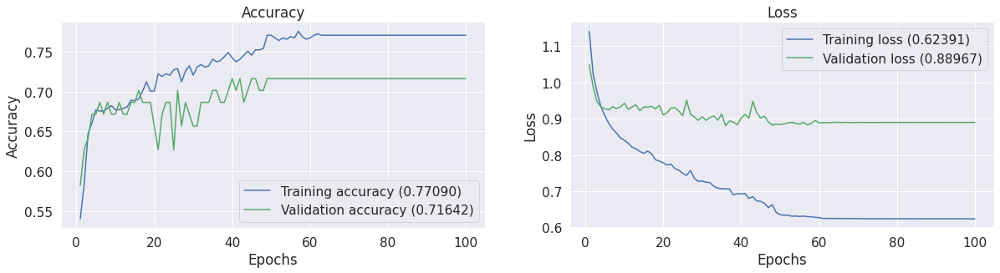

CPU times: user 613 ms, sys: 7.89 ms, total: 621 ms
Wall time: 626 ms


In [ ]:
%%time
#Plot Keras History
#Plot loss and accuracy for the training and validation set.
def plot_history(history):
    loss_list = [s for s in history.history.keys() if 'loss' in s and 'val' not in s]
    val_loss_list = [s for s in history.history.keys() if 'loss' in s and 'val' in s]
    acc_list = [s for s in history.history.keys() if 'acc' in s and 'val' not in s]
    val_acc_list = [s for s in history.history.keys() if 'acc' in s and 'val' in s]
    if len(loss_list) == 0:
        print('Loss is missing in history')
        return 
    plt.figure(figsize=(22,10))
    ## As loss always exists
    epochs = range(1,len(history.history[loss_list[0]]) + 1)
    ## Accuracy
    plt.figure(221, figsize=(20,10))
    ## Accuracy
    # plt.figure(2,figsize=(14,5))
    plt.subplot(221, title='Accuracy')
    for l in acc_list:
        plt.plot(epochs, history.history[l], 'b', label='Training accuracy (' + str(format(history.history[l][-1],'.5f'))+')')
    for l in val_acc_list:    
      plt.plot(epochs, history.history[l], 'g', label='Validation accuracy (' + str(format(history.history[l][-1],'.5f'))+')')
    plt.title('Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()
    ## Loss
    plt.subplot(222, title='Loss')
    for l in loss_list:
        plt.plot(epochs, history.history[l], 'b', label='Training loss (' + str(str(format(history.history[l][-1],'.5f'))+')'))
    for l in val_loss_list:
        plt.plot(epochs, history.history[l], 'g', label='Validation loss (' + str(str(format(history.history[l][-1],'.5f'))+')'))    
    plt.title('Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

# plot history
plot_history(history)

In [ ]:
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        title='Normalized confusion matrix'
    else:
        title='Confusion matrix'
        
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.show()

In [ ]:
# prediction class 
y_pred = model.predict_classes(x_test, batch_size=32)
print ("prediction test return :",y_pred[1], "-", int_to_label[y_pred[1]])

prediction test return : 2 - normal
